## Introduction Notebook

In [127]:
import numpy as np
import pandas as pd
from sklearn.neighbors import NearestNeighbors
from aux import *
import time

t1 = time.time()
df = pd.read_csv('preprocessed_collisions.csv')
t2 = time.time()
print(f'Done doing the preprocessing. Time elapsed {t2-t1} seconds.')

Done doing the preprocessing. Time elapsed 9.65894603729248 seconds.


In [128]:
df['YEAR'] = pd.to_datetime(df['CRASH DATE']).dt.year
df['MONTH'] = pd.to_datetime(df['CRASH DATE']).dt.month

# Introduction to the dataset

## Where do the crashes occur?

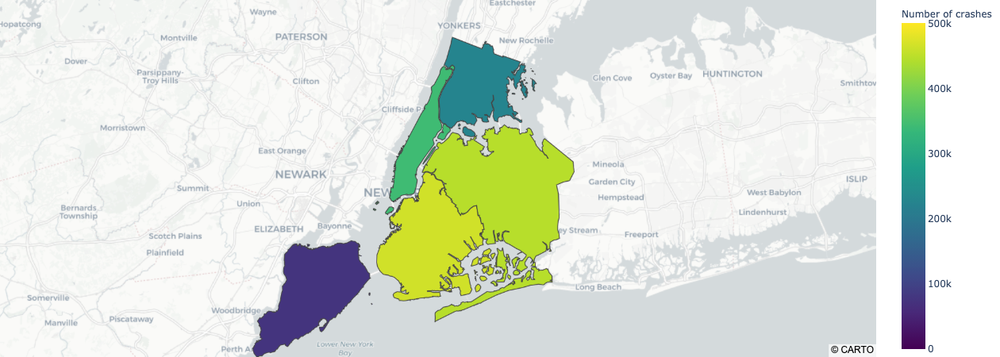

In [2]:
df3 = pd.DataFrame({'BOROUGH' : df.groupby('BOROUGH').size().index, 'values' : df.groupby('BOROUGH').size().values})
df3['BOROUGH'] = df3['BOROUGH'].apply(lambda x : x.title())

import plotly.express as px
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/dwillis/nyc-maps/master/boroughs.geojson') as response:
    counties = json.load(response)
    
import plotly.express as px

fig = px.choropleth_mapbox(df3, geojson=counties, locations='BOROUGH', color='values', featureidkey="properties.BoroName",
                           color_continuous_scale="Viridis",
                           range_color=(0, 500000),
                           center={"lat": 40.730610, "lon": -73.935242},
                           labels={'values':'Number of crashes'},
                           mapbox_style="carto-positron", zoom=9
                          )

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## Where do they occur (zip code?)

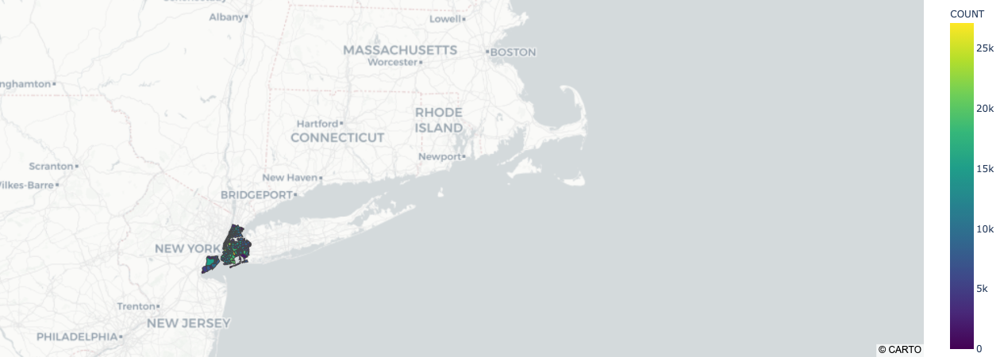

In [3]:
import plotly.express as px
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/fedhere/PUI2015_EC/master/mam1612_EC/nyc-zip-code-tabulation-areas-polygons.geojson') as response:
    counties = json.load(response)
    
import plotly.express as px

fig = px.choropleth_mapbox(pd.DataFrame({'ZIP' : df.groupby('ZIP CODE').size().index, 'COUNT' : df.groupby('ZIP CODE').size().values}), 
                           geojson=counties, locations='ZIP', color='COUNT', featureidkey="properties.postalCode",
                           color_continuous_scale="Viridis",
                           range_color=(0, 27093),
                           center={"lat": 40.730610, "lon": -73.935242},
                           labels={'values':'Number of crashes'},
                           mapbox_style="carto-positron", zoom=9
                          )

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## Heatmap

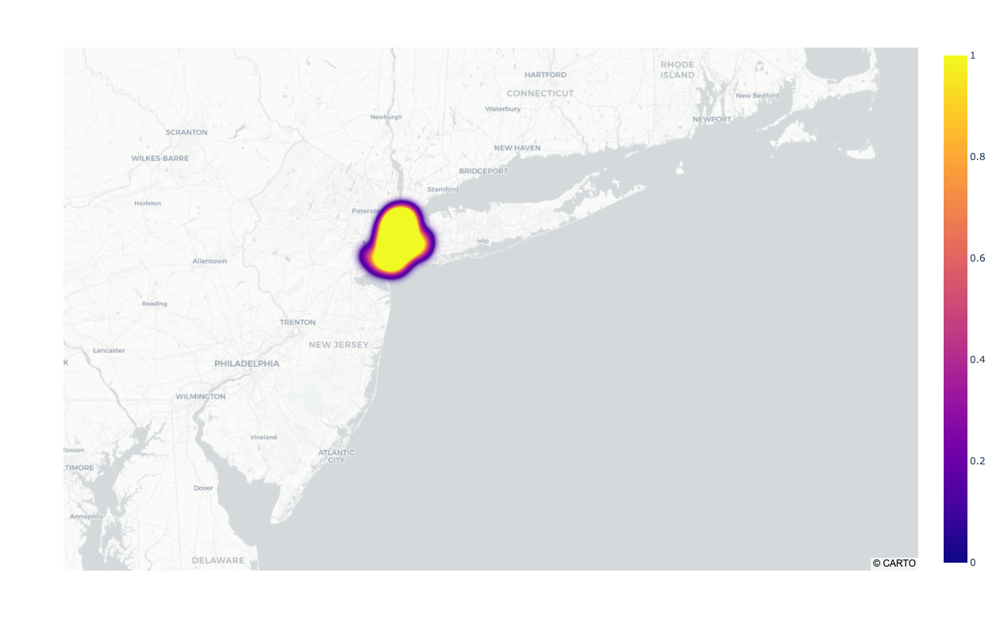

In [4]:
import plotly.express as px
fig = px.density_mapbox(df.iloc[:100,:], lat='LATITUDE', lon='LONGITUDE', radius=25,
                        center=dict(lat=40.730610, lon=-73.935242), zoom=9,
                        mapbox_style="carto-positron",
                       width = 800, height = 800)
fig.show()

# Where do they happen?

In [5]:
df['YEAR'] = pd.to_datetime(df['CRASH DATE']).dt.year
df['MONTH'] = pd.to_datetime(df['CRASH DATE']).dt.month

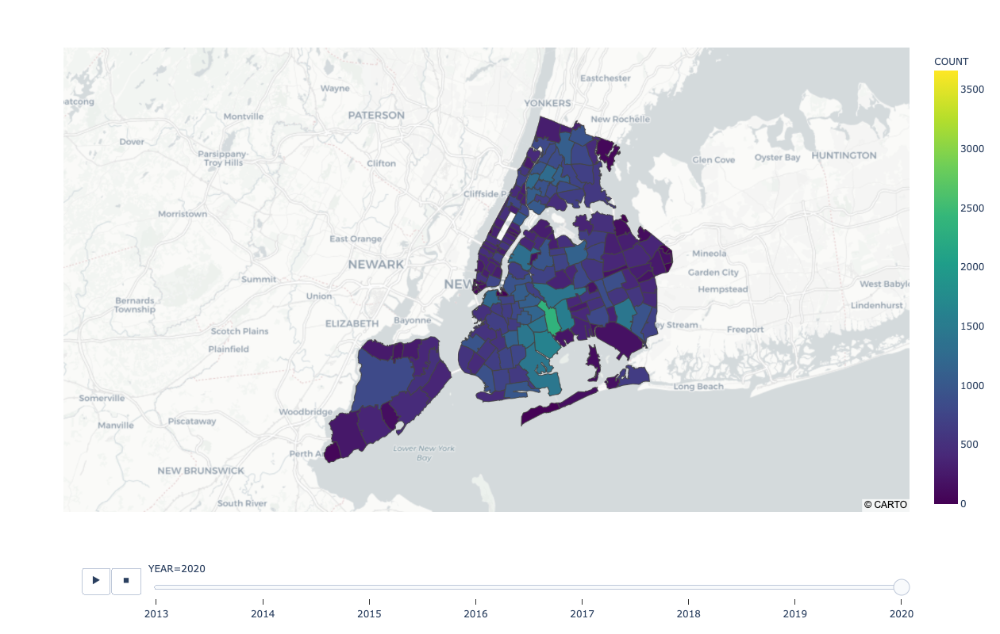

In [59]:
df_test = pd.DataFrame({'ZIP CODE' : [x[0] for x in df.groupby(['ZIP CODE', 'YEAR']).size().index],
                        'YEAR' : [x[1] for x in df.groupby(['ZIP CODE', 'YEAR']).size().index],
                        'COUNT' : df.groupby(['ZIP CODE', 'YEAR']).size().values})

#Remove 2012 and 2021.
df_test = df_test.loc[df_test['YEAR'].apply(lambda x : x not in [2012, 2021])]

df_test = df_test.sort_values(by=['ZIP CODE', 'YEAR'])

import plotly.express as px
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/fedhere/PUI2015_EC/master/mam1612_EC/nyc-zip-code-tabulation-areas-polygons.geojson') as response:
    counties = json.load(response)
    
import plotly.express as px

fig = px.choropleth_mapbox(df_test, geojson=counties, locations='ZIP CODE', color='COUNT', 
                           featureidkey="properties.postalCode",
                           color_continuous_scale="Viridis",
                           range_color=(0, df_test['COUNT'].max()),
                           animation_frame="YEAR",
                           category_orders={"YEAR": range(2013, 2021)},
                           center={"lat": 40.730610, "lon": -73.935242},
                           labels={'values':'Number of crashes'},
                           mapbox_style="carto-positron", zoom=9,
                           width = 800, height = 800
                          )

fig.show()

In [18]:
df

,Unnamed: 0,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,...,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5,CONTRIBUTING FACTORS (SPECIFIC),CONTRIBUTING FACTORS (GENERAL),VEHICLE TYPES
0,0,03/29/2021,18:00,BROOKLYN,11221,40.691730,-73.935170,"(40.69173, -73.93517)",NaN,NaN,...,NaN,4403352,Sedan,NaN,NaN,NaN,NaN,NaN,NaN,Car
1,5,03/26/2021,15:47,BROOKLYN,11209,40.616547,-74.026070,"(40.616547, -74.02607)",BROOKLYN QUEENS EXPRESSWAY,NaN,...,NaN,4402349,Sedan,Sedan,NaN,NaN,NaN,NaN,NaN,"Car, Car"
2,10,03/24/2021,11:00,BROOKLYN,11232,40.651676,-74.010635,"(40.651676, -74.010635)",43 STREET,NaN,...,NaN,4401674,Sedan,NaN,NaN,NaN,NaN,NaN,NaN,Car
3,12,03/23/2021,11:30,QUEENS,11369,40.768360,-73.874160,"(40.76836, -73.87416)",NaN,NaN,...,NaN,4401374,Taxi,NaN,NaN,NaN,NaN,Animals Action,Physical Surroundings,Taxi
4,21,03/19/2021,12:49,BROOKLYN,11234,40.598392,-73.906290,"(40.598392, -73.90629)",BELT PARKWAY,NaN,...,NaN,4401908,Sedan,Sedan,NaN,NaN,NaN,NaN,NaN,"Car, Car"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1555777,1766634,07/01/2012,13:55,BROOKLYN,11232,40.651616,-74.010607,"(40.6516157, -74.0106071)",NaN,NaN,...,NaN,2964850,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN,NaN,NaN,"Car, Car"
1555778,1766635,07/01/2012,10:45,QUEENS,11358,40.761162,-73.788659,"(40.7611615, -73.788659)",NaN,NaN,...,NaN,259353,PASSENGER VEHICLE,UNKNOWN,NaN,NaN,NaN,NaN,NaN,"Car, Unknown"
1555779,1766636,07/01/2012,20:45,QUEENS,11372,40.754416,-73.878529,"(40.7544157, -73.8785293)",89 STREET,34 AVENUE,...,NaN,279644,PASSENGER VEHICLE,PASSENGER VEHICLE,PASSENGER VEHICLE,NaN,NaN,NaN,NaN,"Car, Car, Car"
1555780,1766637,07/02/2012,2:00,QUEENS,11420,40.681739,-73.805091,"(40.6817395, -73.8050906)",NaN,NaN,...,NaN,3096745,MOTORCYCLE,SPORT UTILITY / STATION WAGON,NaN,NaN,NaN,Fatigued/Drowsy,Physical Disability,"Car, Motorcycle"


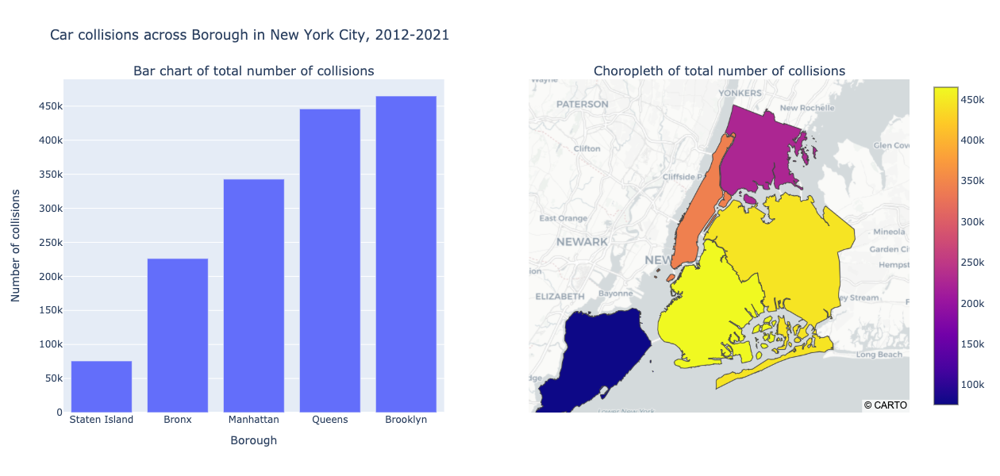

In [102]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

import plotly.express as px
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/dwillis/nyc-maps/master/boroughs.geojson') as response:
    counties = json.load(response)

fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'xy'},{"type": "mapbox"}]],
                   subplot_titles=('Bar chart of total number of collisions', 'Choropleth of total number of collisions'))
df_temp = pd.DataFrame({'Borough' : [x.title() for x in df.groupby('BOROUGH').size().index], 'Count' : df.groupby('BOROUGH').size().values})\
            .sort_values(by='Count')

fig.add_trace(
    go.Bar(x = df_temp['Borough'], y=df_temp['Count']),
    row=1, col=1
)

fig.add_trace(
    go.Choroplethmapbox(geojson=counties, locations=df_temp['Borough'], z=df_temp['Count'], featureidkey='properties.BoroName'),
    row=1, col=2
)
fig.update_layout(mapbox_style="carto-positron", mapbox_center = {"lat": 40.730610, "lon": -73.935242}, mapbox_zoom=9)
fig.update_layout(height=600, width=1200, title_text='Car collisions across Borough in New York City, 2012-2021')

# edit axis labels
fig['layout']['xaxis']['title']='Borough'
fig['layout']['yaxis']['title']='Number of collisions'

fig.show()

0          18
1          15
2          11
3          11
4          12
           ..
1555777    13
1555778    10
1555779    20
1555780     2
1555781    18
Name: CRASH TIME, Length: 1555782, dtype: int64

In [195]:
df_temp = pd.DataFrame({'Hour of week' : np.tile(np.arange(0, 24), 7), 
                        'Collisions' : df.groupby([pd.to_datetime(df['CRASH DATE']).dt.weekday, pd.to_datetime(df['CRASH TIME']).dt.hour]).size().unstack().fillna(0).values.reshape(-1,)})

In [196]:
df_temp['Day'] = ['Monday']*24 + ['Tuesday']*24 + ['Wednesday']*24 + ['Thursday']*24 + ['Friday']*24 + ['Saturday']*24 + ['Sunday']*24

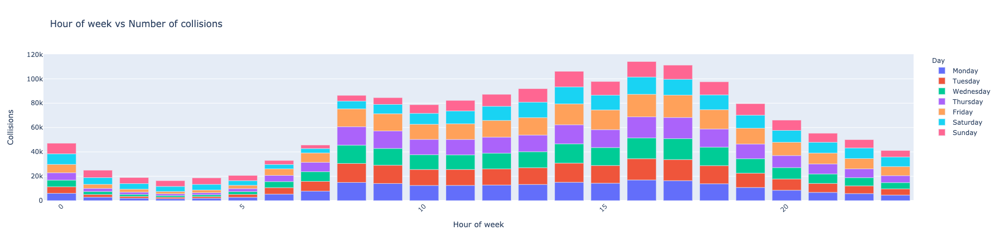

In [199]:
import plotly.express as px
fig = px.bar(df_temp, x='Hour of week', y='Collisions', color='Day',
            title='Hour of week vs Number of collisions')
fig.update_layout(barmode='relative', xaxis_tickangle=-45)
fig.show()


In [107]:
# Build App
app = JupyterDash(__name__)

app.layout = html.Div(
    children=[
        html.Div(
            children=[
                html.H1(
                    children="Car Collisions in New York City", className="header-title"
                ),
                html.P(
                    children="Final project for 02806 Social Data Analysis and Visualization.",
                    className="header-description",
                ),
            ],
            className="header",
        ),
        dcc.Markdown(f'''
            # Introduction
            
            First of all, **welcome** to our webpage! This webpage was made as our final project for 02806 Social Data Analysis and Visualization. We want to take a closer look
            on car collisions in New York City. When you have read this page, you should know more about **when** accidents occur, **why** they occur and **what** you as a driver can do to prevent
            it from happening!
            
            
            ## Where in New York City do car collisions occur?
            
            '''),
        dcc.Graph(figure=fig),
        dcc.Markdown(f'''
            Generally, we can see that most motor collisions occur outside of Manhattan, which is what we usually refer to as downtown New York.
            '''),
        dcc.Markdown(f'''
            ## When do car collisions occur?
            '''),
    ]
)
# Run app and display result inline in the notebook
app.run_server(mode='inline')

In [1]:
import plotly.express as px
from jupyter_dash import JupyterDash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output

# Load Data
df = px.data.tips()

# Build App
app = JupyterDash(__name__)

app.layout = html.Div(
    children=[
        html.Div(
            children=[
                html.P(children="🥑", className="header-emoji"),
                html.H1(
                    children="Car Collisions in New York City", className="header-title"
                ),
                html.P(
                    children="Final project for 02806 Social Data Analysis and Visualization.",
                    className="header-description",
                ),
            ],
            className="header",
        ),
        dcc.Markdown('''
            # Introduction 
            
            This is the introduction, and here, we will show some general stuff about the dataset. 
            ''', style={'margin-left' : 50}),
        dcc.Tabs([
        dcc.Tab(label='Contributing Factor 1', children=[
            dcc.Markdown('''
            # Contributing Factor 1
            
            This is just plain markdown. This can be used for writing some stuff.
            ''', style={'margin-left' : 50}),
            dcc.Graph(
                figure={
                    'data': [
                        {'x': [1, 2, 3], 'y': [15, 1, 2],
                            'type': 'bar', 'name': 'SF'},
                        {'x': [1, 2, 3], 'y': [2, 4, 5],
                         'type': 'bar', 'name': u'Montréal'},
                    ]
                }
            )
        ]),
        dcc.Tab(label='Contributing Factor 2', children=[
            dcc.Markdown('''
            # Contributing Factor 2
            
            This is just plain markdown. This can be used for writing some stuff.
            ''', style={'margin-left' : 50}),
            dcc.Graph(
                figure={
                    'data': [
                        {'x': [1, 2, 3], 'y': [25, 1, 2],
                            'type': 'bar', 'name': 'SF'},
                        {'x': [1, 2, 3], 'y': [2, 4, 5],
                         'type': 'bar', 'name': u'Montréal'},
                    ]
                }
            )
        ]),
        dcc.Tab(label='Contributing Factor 3', children=[
            dcc.Markdown('''
            # Contributing Factor 3
            
            This is just plain markdown. This can be used for writing some stuff.
            ''', style={'margin-left' : 50}),
            dcc.Graph(
                figure={
                    'data': [
                        {'x': [1, 2, 3], 'y': [5, 1, 2],
                            'type': 'bar', 'name': 'SF'},
                        {'x': [1, 2, 3], 'y': [2, 4, 5],
                         'type': 'bar', 'name': u'Montréal'},
                    ]
                }
            )
        ]),
        dcc.Tab(label='Contributing Factor 4', children=[
            dcc.Markdown('''
            # Contributing Factor 4
            
            This is just plain markdown. This can be used for writing some stuff.
            ''', style={'margin-left' : 50}),
            dcc.Graph(
                figure={
                    'data': [
                        {'x': [1, 2, 3], 'y': [8, 1, 2],
                            'type': 'bar', 'name': 'SF'},
                        {'x': [1, 2, 3], 'y': [2, 4, 5],
                         'type': 'bar', 'name': u'Montréal'},
                    ]
                }
            )
        ]),
        dcc.Tab(label='Contributing Factor 5', children=[
            dcc.Markdown('''
            # Contributing Factor 5
            
            This is just plain markdown. This can be used for writing some stuff.
            ''', style={'margin-left' : 50}),
            dcc.Graph(
                figure={
                    'data': [
                        {'x': [1, 2, 3], 'y': [11, 1, 2],
                            'type': 'bar', 'name': 'SF'},
                        {'x': [1, 2, 3], 'y': [2, 4, 5],
                         'type': 'bar', 'name': u'Montréal'},
                    ]
                }
            )
        ]),
        dcc.Tab(label='Contributing Factor 6', children=[
            dcc.Markdown('''
            # Contributing Factor 6
            
            This is just plain markdown. This can be used for writing some stuff.
            ''', style={'margin-left' : 50}),
            dcc.Graph(
                figure={
                    'data': [
                        {'x': [1, 2, 3], 'y': [4, 1, 2],
                            'type': 'bar', 'name': 'SF'},
                        {'x': [1, 2, 3], 'y': [2, 4, 5],
                         'type': 'bar', 'name': u'Montréal'},
                    ]
                }
            )
        ]),
        ]),
        html.Div(
            children=[
            dcc.Markdown('''
            # Conclusions 
            
            Here is where we write the conclusions about the data.
            ''', style={'margin-left' : 50}),
            ],
            className="wrapper",
        ),
    ]
)
# Run app and display result inline in the notebook
app.run_server(mode='inline')